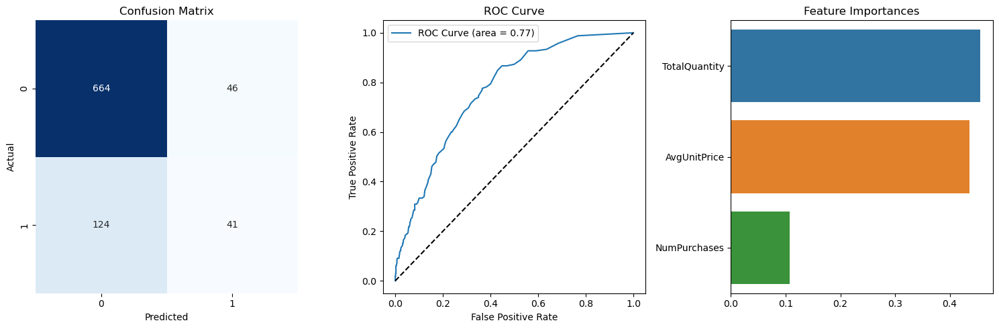

Confusion Matrix:
[[664  46]
 [124  41]]

Classification Report:
              precision    recall  f1-score   support

       False       0.84      0.94      0.89       710
        True       0.47      0.25      0.33       165

    accuracy                           0.81       875
   macro avg       0.66      0.59      0.61       875
weighted avg       0.77      0.81      0.78       875


ROC AUC: 0.77

Customer Features:
   CustomerID  TotalQuantity  AvgUnitPrice  NumPurchases  Churned
0     12346.0              0      1.040000             2     True
1     12347.0           2458      2.644011             7    False
2     12348.0           2341      5.764839             4    False
3     12349.0            631      8.289041             1    False
4     12350.0            197      3.841176             1     True


{'confusion_matrix': array([[664,  46],
        [124,  41]], dtype=int64),
 'classification_report': '              precision    recall  f1-score   support\n\n       False       0.84      0.94      0.89       710\n        True       0.47      0.25      0.33       165\n\n    accuracy                           0.81       875\n   macro avg       0.66      0.59      0.61       875\nweighted avg       0.77      0.81      0.78       875\n',
 'roc_auc': 0.7672087067861715,
 'feature_importances': array([0.4561074 , 0.43625933, 0.10763328])}

In [84]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
import plotly.express as px
from sklearn.tree import DecisionTreeRegressor


# Load the dataset
file_path = 'data.csv'
data = pd.read_csv(file_path, encoding='ISO-8859-1')

# Convert InvoiceDate to datetime format
data['InvoiceDate'] = pd.to_datetime(data['InvoiceDate'])

# Identify the last transaction date in the dataset
last_transaction_date = data['InvoiceDate'].max()

# Calculate recency for each customer
recency = data.groupby('CustomerID')['InvoiceDate'].max().reset_index()
recency.columns = ['CustomerID', 'LastPurchaseDate']
recency['RecencyDays'] = (last_transaction_date - recency['LastPurchaseDate']).dt.days

# Define churned customers as those who haven't made a purchase in the last 6 months (180 days)
recency['Churned'] = recency['RecencyDays'] > 180

# Merge recency data with original dataset
data = data.merge(recency[['CustomerID', 'Churned']], on='CustomerID', how='left')

# Feature Engineering
# Create features: total spending, average spending per purchase, frequency of purchases
features = data.groupby('CustomerID').agg({
    'Quantity': 'sum',
    'UnitPrice': 'mean',
    'InvoiceNo': 'nunique',
    'Churned': 'max'
}).reset_index()

features.columns = ['CustomerID', 'TotalQuantity', 'AvgUnitPrice', 'NumPurchases', 'Churned']

# Split data into training and testing sets
X = features[['TotalQuantity', 'AvgUnitPrice', 'NumPurchases']]
y = features['Churned']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest Classifier
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Predict churn on the test set
y_pred = model.predict(X_test)
y_prob = model.predict_proba(X_test)[:, 1]

# Evaluate the model
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)
fpr, tpr, thresholds = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

# Visualize the results
plt.figure(figsize=(15, 5))

# Confusion Matrix
plt.subplot(1, 3, 1)
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')

# ROC Curve
plt.subplot(1, 3, 2)
plt.plot(fpr, tpr, label=f'ROC Curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()

# Feature Importances
plt.subplot(1, 3, 3)
importances = model.feature_importances_
feature_names = X.columns
sns.barplot(x=importances, y=feature_names)
plt.title('Feature Importances')

plt.tight_layout()
plt.show()

# Summary
summary = {
    'confusion_matrix': conf_matrix,
    'classification_report': class_report,
    'roc_auc': roc_auc,
    'feature_importances': importances
}

print("Confusion Matrix:")
print(conf_matrix)
print("\nClassification Report:")
print(class_report)
print(f"\nROC AUC: {roc_auc:.2f}")

# Displaying the feature dataframe
print("\nCustomer Features:")
print(features.head())

# Displaying the summary
summary


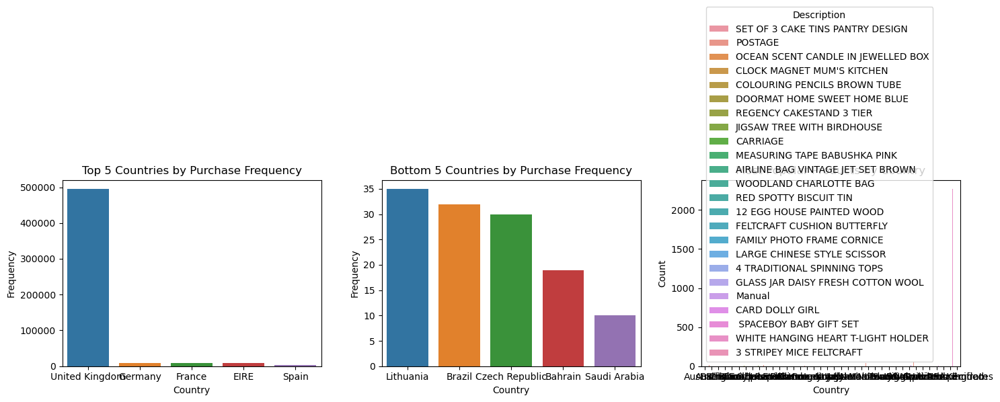

Top 5 Countries by Purchase Frequency:
['United Kingdom', 'Germany', 'France', 'EIRE', 'Spain']

Bottom 5 Countries by Purchase Frequency:
['Lithuania', 'Brazil', 'Czech Republic', 'Bahrain', 'Saudi Arabia']

Most Popular Products by Country:
                 Country                         Description  Count
0              Australia   SET OF 3 CAKE TINS PANTRY DESIGN      10
1                Austria                             POSTAGE     14
2                Bahrain  OCEAN SCENT CANDLE IN JEWELLED BOX      3
3                Belgium                             POSTAGE     98
4                 Brazil          CLOCK MAGNET MUM'S KITCHEN      1
5                 Canada        COLOURING PENCILS BROWN TUBE      3
6        Channel Islands       DOORMAT HOME SWEET HOME BLUE       7
7                 Cyprus            REGENCY CAKESTAND 3 TIER      8
8         Czech Republic          JIGSAW TREE WITH BIRDHOUSE      3
9                Denmark                             POSTAGE     14
10       

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns



# Convert InvoiceDate to datetime format
data['InvoiceDate'] = pd.to_datetime(data['InvoiceDate'])

# Frequency of purchases by country
country_freq = data['Country'].value_counts().reset_index()
country_freq.columns = ['Country', 'Frequency']

# Most frequent countries (Top 5)
top_countries = country_freq.head(5)['Country']

# Least frequent countries (Bottom 5)
bottom_countries = country_freq.tail(5)['Country']

# Filter data for top and bottom countries
top_country_data = data[data['Country'].isin(top_countries)]
bottom_country_data = data[data['Country'].isin(bottom_countries)]

# Most popular products in each country
popular_products = data.groupby(['Country', 'Description']).size().reset_index(name='Count')
popular_products = popular_products.sort_values(['Country', 'Count'], ascending=[True, False])

# Get the most popular product for each country
most_popular_products = popular_products.groupby('Country').first().reset_index()

# Visualizations
plt.figure(figsize=(15, 5))

# Plot purchase frequency for top countries
plt.subplot(1, 3, 1)
sns.barplot(x='Country', y='Frequency', data=country_freq.head(5))
plt.title('Top 5 Countries by Purchase Frequency')
plt.xlabel('Country')
plt.ylabel('Frequency')

# Plot purchase frequency for bottom countries
plt.subplot(1, 3, 2)
sns.barplot(x='Country', y='Frequency', data=country_freq.tail(5))
plt.title('Bottom 5 Countries by Purchase Frequency')
plt.xlabel('Country')
plt.ylabel('Frequency')

# Plot most popular products in each country
plt.subplot(1, 3, 3)
sns.barplot(x='Country', y='Count', hue='Description', data=most_popular_products)
plt.title('Most Popular Products by Country')
plt.xlabel('Country')
plt.ylabel('Count')

plt.tight_layout()
plt.show()

# Summary
summary = {
    'top_countries': top_countries.tolist(),
    'bottom_countries': bottom_countries.tolist(),
    'most_popular_products': most_popular_products
}

print("Top 5 Countries by Purchase Frequency:")
print(top_countries.tolist())

print("\nBottom 5 Countries by Purchase Frequency:")
print(bottom_countries.tolist())

print("\nMost Popular Products by Country:")
print(most_popular_products)


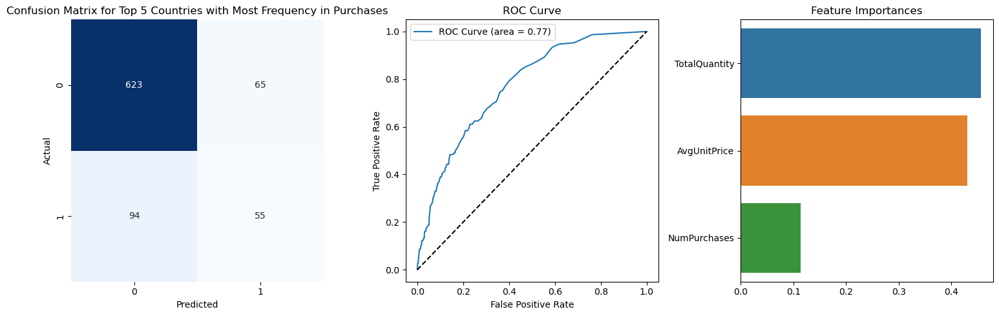

Confusion Matrix for Top 5 Countries with Most Frequency in Purchases:
[[623  65]
 [ 94  55]]

Classification Report for Top 5 Countries with Most Frequency in Purchases:
              precision    recall  f1-score   support

       False       0.87      0.91      0.89       688
        True       0.46      0.37      0.41       149

    accuracy                           0.81       837
   macro avg       0.66      0.64      0.65       837
weighted avg       0.80      0.81      0.80       837


ROC AUC for Top 5 Countries with Most Frequency in Purchases: 0.77


C:\Users\19294\anaconda3\Lib\site-packages\sklearn\metrics\_ranking.py:1123: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(


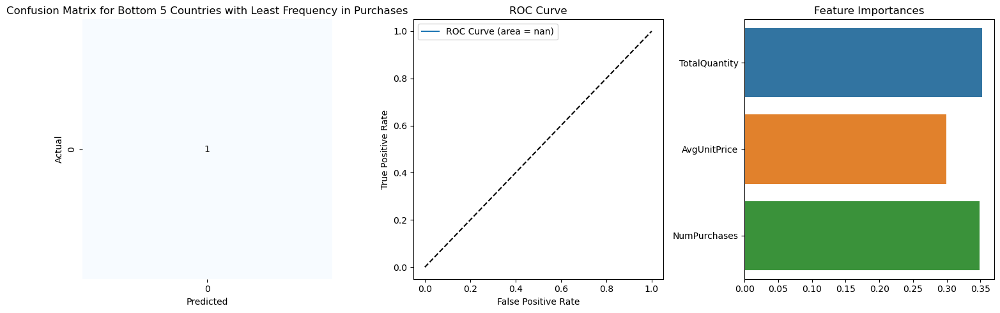

Confusion Matrix for Bottom 5 Countries with Least Frequency in Purchases:
[[1]]

Classification Report for Bottom 5 Countries with Least Frequency in Purchases:
              precision    recall  f1-score   support

        True       1.00      1.00      1.00         1

    accuracy                           1.00         1
   macro avg       1.00      1.00      1.00         1
weighted avg       1.00      1.00      1.00         1


ROC AUC for Bottom 5 Countries with Least Frequency in Purchases: nan

Most Popular Products in Each Country:
           Country StockCode                         Description  Quantity
226      Australia     22492             MINI PAINT SET VINTAGE       2916
399      Australia     23084                  RABBIT NIGHT LIGHT      1884
108      Australia     21915              RED  HARMONICA IN BOX       1704
90       Australia     21731       RED TOADSTOOL LED NIGHT LIGHT      1344
268      Australia     22630                DOLLY GIRL LUNCH BOX      1024
... 

# Customer Preferences
Model for Popular Items. This identifies the most popular items by calculating the total quantity purchased for each product.

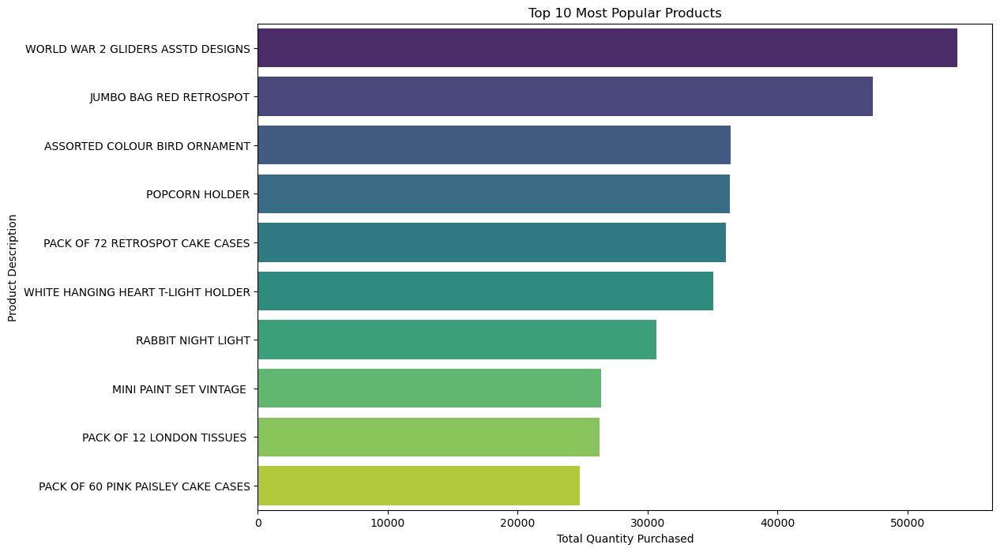

Top 10 Most Popular Products:
     StockCode                         Description  Quantity
3617     84077   WORLD WAR 2 GLIDERS ASSTD DESIGNS     53847
4197    85099B             JUMBO BAG RED RETROSPOT     47363
3956     84879       ASSORTED COLOUR BIRD ORNAMENT     36381
1333     22197                      POPCORN HOLDER     36334
531      21212     PACK OF 72 RETROSPOT CAKE CASES     36039
4223    85123A  WHITE HANGING HEART T-LIGHT HOLDER     35025
2344     23084                  RABBIT NIGHT LIGHT     30680
1630     22492             MINI PAINT SET VINTAGE      26437
1775     22616          PACK OF 12 LONDON TISSUES      26315
1122     21977  PACK OF 60 PINK PAISLEY CAKE CASES     24753


In [26]:
# Convert InvoiceDate to datetime format
data['InvoiceDate'] = pd.to_datetime(data['InvoiceDate'])

# Aggregate product data to find popular items
popular_items = data.groupby(['StockCode', 'Description']).agg({'Quantity': 'sum'}).reset_index()

# Identify top 10 most common products
top_popular_items = popular_items.sort_values(by='Quantity', ascending=False).head(10)

# Visualize the top products
plt.figure(figsize=(12, 8))
sns.barplot(x='Quantity', y='Description', data=top_popular_items, palette='viridis')
plt.title('Top 10 Most Popular Products')
plt.xlabel('Total Quantity Purchased')
plt.ylabel('Product Description')
plt.show()

# Display the top products
print("Top 10 Most Popular Products:")
print(top_popular_items)

# Model: Product Categories
Identify common themes or categories among the top products.

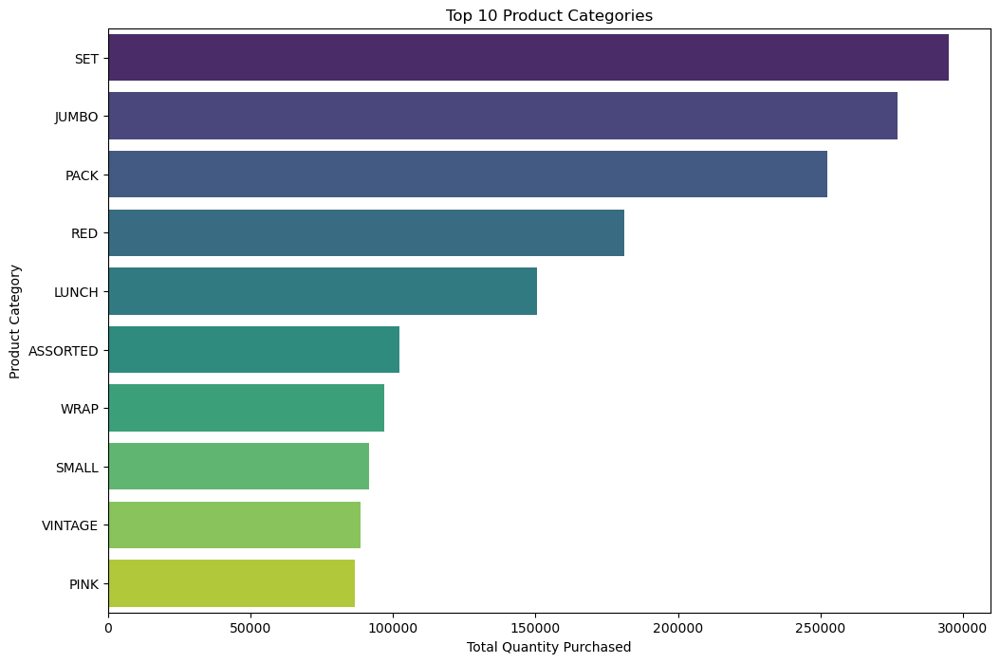

Top 10 Product Categories:
     Category  Quantity
719       SET    294983
444     JUMBO    277036
582      PACK    252329
672       RED    181226
489     LUNCH    150573
65   ASSORTED    102263
879      WRAP     96855
750     SMALL     91532
852   VINTAGE     88556
620      PINK     86732


In [31]:
# Assuming the product descriptions contain the category information
# Aggregate product data to find popular items
popular_items['Category'] = popular_items['Description'].apply(lambda x: x.split()[0])  # Simplified category extraction

# Aggregate by category
category_data = popular_items.groupby('Category').agg({'Quantity': 'sum'}).reset_index()

# Identify top 10 categories
top_categories = category_data.sort_values(by='Quantity', ascending=False).head(10)

# Visualize the top categories
plt.figure(figsize=(12, 8))
sns.barplot(x='Quantity', y='Category', data=top_categories, palette='viridis')
plt.title('Top 10 Product Categories')
plt.xlabel('Total Quantity Purchased')
plt.ylabel('Product Category')
plt.show()

# Display the top categories
print("Top 10 Product Categories:")
print(top_categories)


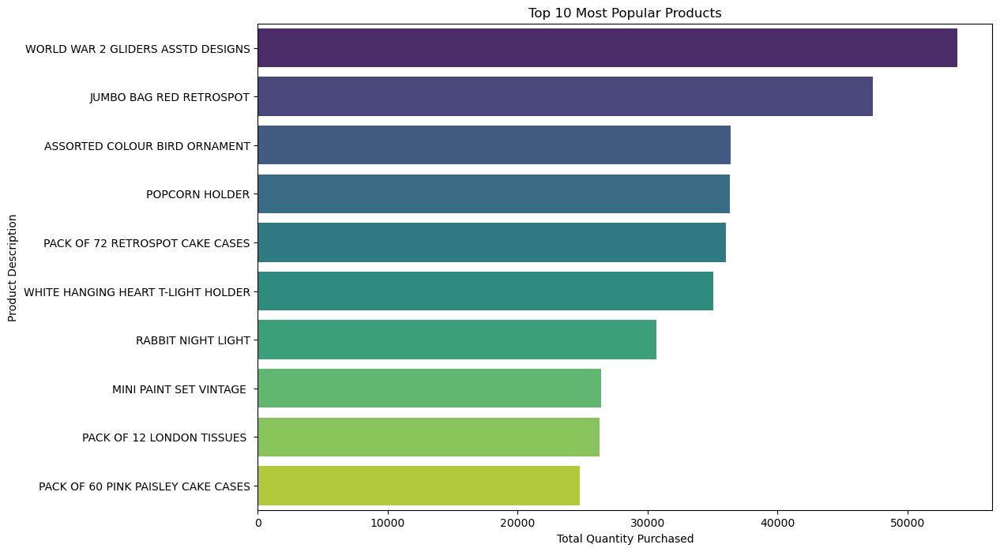

Top 10 Most Popular Products:
     StockCode                         Description  Quantity
3617     84077   WORLD WAR 2 GLIDERS ASSTD DESIGNS     53847
4197    85099B             JUMBO BAG RED RETROSPOT     47363
3956     84879       ASSORTED COLOUR BIRD ORNAMENT     36381
1333     22197                      POPCORN HOLDER     36334
531      21212     PACK OF 72 RETROSPOT CAKE CASES     36039
4223    85123A  WHITE HANGING HEART T-LIGHT HOLDER     35025
2344     23084                  RABBIT NIGHT LIGHT     30680
1630     22492             MINI PAINT SET VINTAGE      26437
1775     22616          PACK OF 12 LONDON TISSUES      26315
1122     21977  PACK OF 60 PINK PAISLEY CAKE CASES     24753


In [45]:

# Preprocess the data
data['InvoiceDate'] = pd.to_datetime(data['InvoiceDate'])

# Aggregate product data
product_data = data.groupby(['StockCode', 'Description']).agg({'Quantity': 'sum'}).reset_index()

# Identify top 10 most common products
top_products = product_data.sort_values(by='Quantity', ascending=False).head(10)

# Visualize the top products
plt.figure(figsize=(12, 8))
sns.barplot(x='Quantity', y='Description', data=top_products, palette='viridis')
plt.title('Top 10 Most Popular Products')
plt.xlabel('Total Quantity Purchased')
plt.ylabel('Product Description')
plt.show()

# Display the top products
print("Top 10 Most Popular Products:")
print(top_products)


In [68]:
data.head()

,InvoiceNo,StockCode,Description,Quantity,UnitPrice,CustomerID,Country,Churned
InvoiceDate,,,,,,,,
2010-12-01 08:26:00,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2.55,17850.0,United Kingdom,True
2010-12-01 08:26:00,536365,71053,WHITE METAL LANTERN,6,3.39,17850.0,United Kingdom,True
2010-12-01 08:26:00,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2.75,17850.0,United Kingdom,True
2010-12-01 08:26:00,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,3.39,17850.0,United Kingdom,True
2010-12-01 08:26:00,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,3.39,17850.0,United Kingdom,True


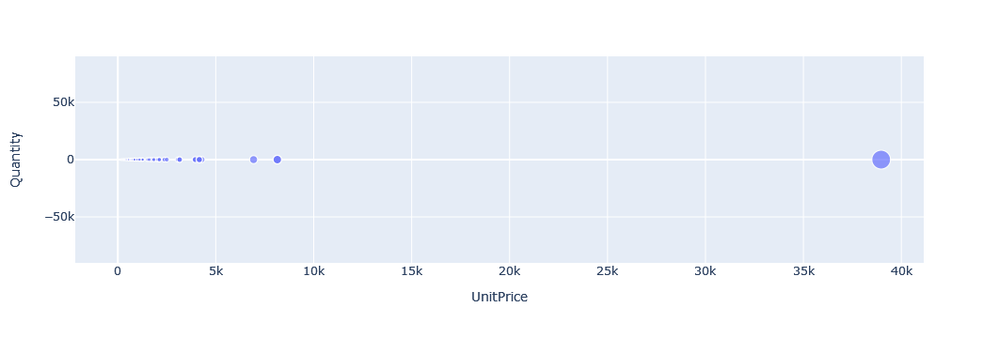